In [1]:
import torch.nn as nn
import torch.nn.functional as F 

from torchvision import models
import cv2

In [2]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

sns.set_palette("deep")
sns.set_style('darkgrid')

import torch
import torch.nn as nn
from torchvision import transforms
from torch.utils.data import DataLoader

from tqdm.notebook import tqdm
from datasets.hams_dataset import HamDataset

In [3]:
preprocess = transforms.Compose([
    transforms.Resize(299),
    transforms.CenterCrop(299),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])

In [4]:
attr = 'dark_corner'
label = 'nv'

biased_train_dataset = HamDataset('train_biased.csv', attr, label, transform = preprocess)
unbiased_train_dataset = HamDataset('train_unbiased.csv', attr, label, transform = preprocess)
val_dataset = HamDataset('val.csv', attr, label, transform = preprocess)
test_dataset = HamDataset('test.csv', attr, label, transform = preprocess)

In [5]:
batch_size = 16

train_biased_dataloader = DataLoader(biased_train_dataset, batch_size=batch_size, shuffle=True)
train_unbiased_dataloader = DataLoader(unbiased_train_dataset, batch_size=batch_size, shuffle=True)
test_dataloader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)
val_dataloader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)

In [6]:
batch_img, label, _ = next(iter(train_biased_dataloader))

In [7]:
class SaveFeatures():
    """ Extract pretrained activations"""
    features=None
    def __init__(self, m):
        self.hook = m.register_forward_hook(self.hook_fn)
    def hook_fn(self, module, input, output):
        self.features = ((output.cpu()).data).numpy()
    def remove(self):
        self.hook.remove()

In [8]:
def get_gradcam_output(model, conv_layer, batch_img, title, classfier_name, num_feature_conv = 0):
    def getCAM(feature_conv, weight_fc, class_idx):
        _, nc, h, w = feature_conv.shape
        cam = weight_fc[class_idx].dot(feature_conv[num_feature_conv, :, :, ].reshape((nc, h*w)))
        cam = cam.reshape(h, w)
        cam = cam - np.min(cam)
        cam_img = cam / np.max(cam)
        return cam_img

    #Hook to get the gradient
    activated_features = SaveFeatures(conv_layer)
    
    output = model(batch_img)
    probabilities = torch.sigmoid(output).cpu().detach().numpy()
    pred_idx = np.round(probabilities).astype(int)
    labels = pred_idx

    #Removing the hook
    activated_features.remove()

    weight_softmax_params = list(model.base_model._modules.get(classfier_name).parameters())
    weight_softmax = np.squeeze(weight_softmax_params[0].cpu().data.numpy())

    heatmaps = [getCAM(activated_features.features, weight_softmax, i) for i in pred_idx]

    fig=plt.figure(figsize=(8, 8))
    for i in range(0, len(batch_img[:8])):
        img = np.clip(torch.permute(batch_img[i], (1,2,0)).data.numpy(), 0, 1)
        mask = heatmaps[i]
        ax = fig.add_subplot(4, 4,i +1,xticks=[], yticks=[])
        plt.imshow(img)
        mask_plt = cv2.resize(mask, (299,299), interpolation=cv2.INTER_LINEAR)
        plt.imshow(mask_plt, alpha=0.5, cmap='jet');
    plt.suptitle(title)
    plt.show()

## Inception Model

In [9]:
inception_biased_model = torch.load("model/saved_model/inception/biased.pickle").to('cpu')

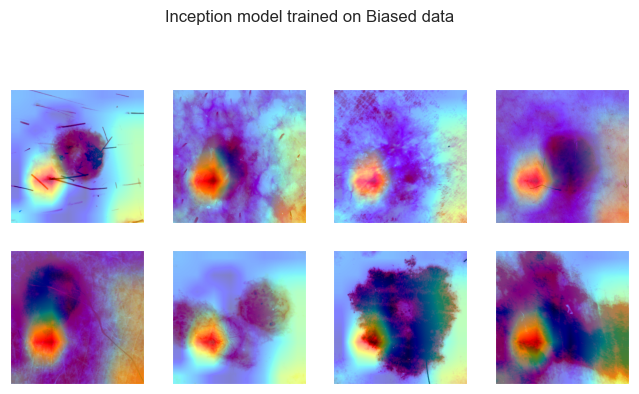

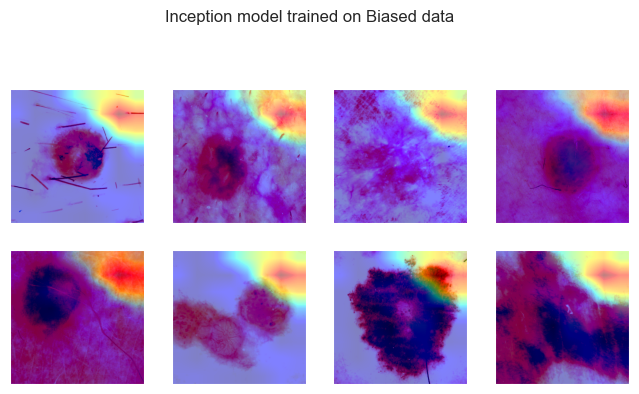

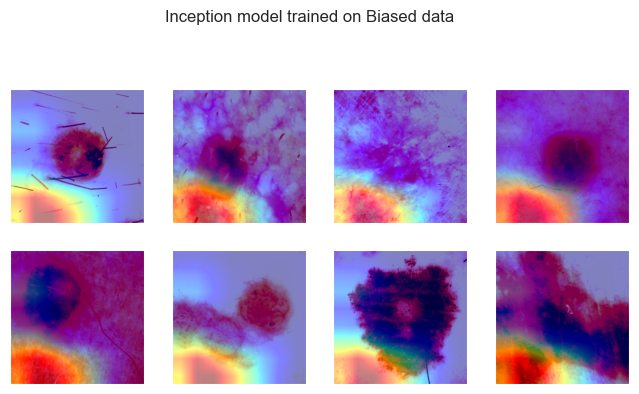

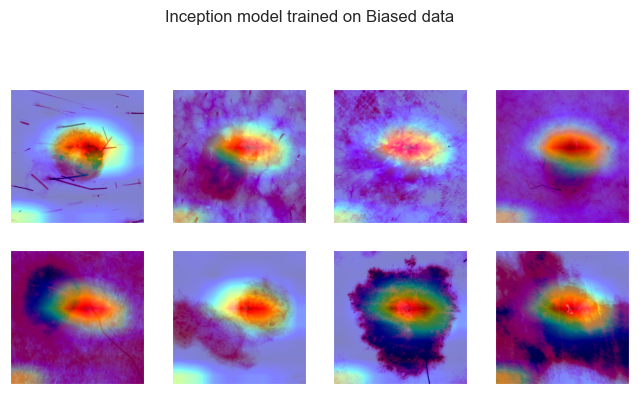

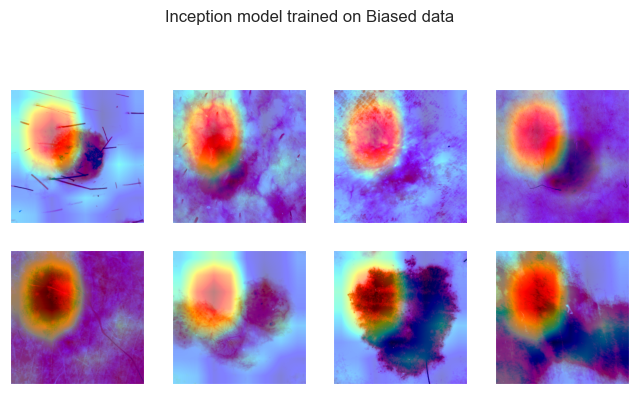

...

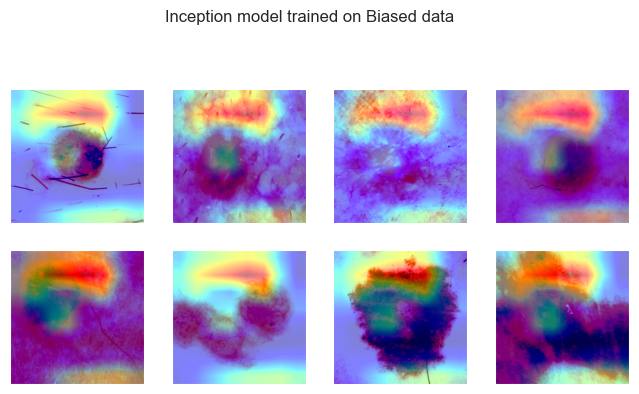

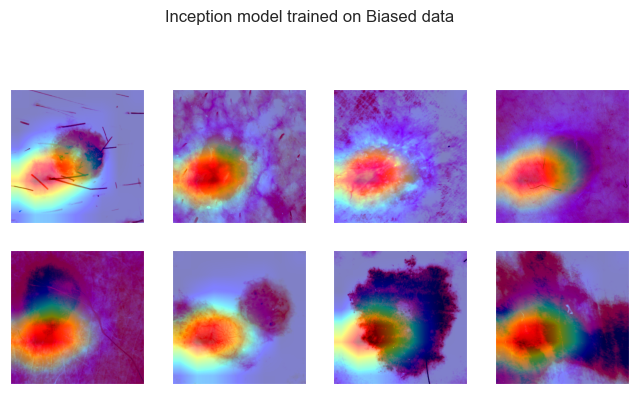

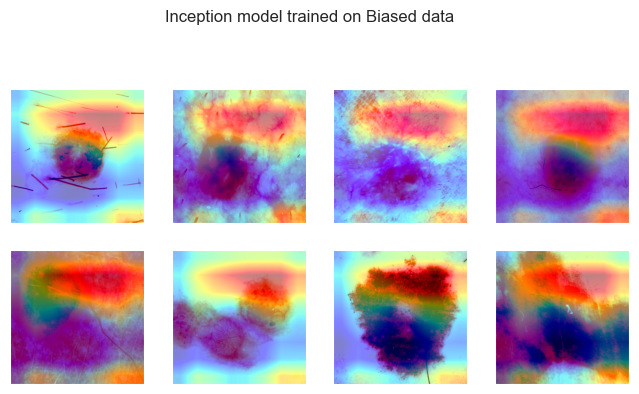

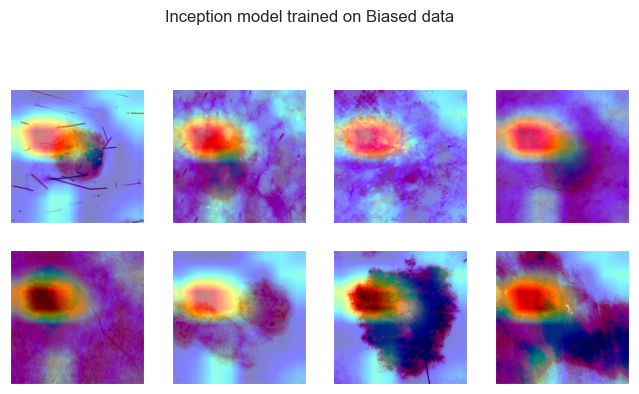

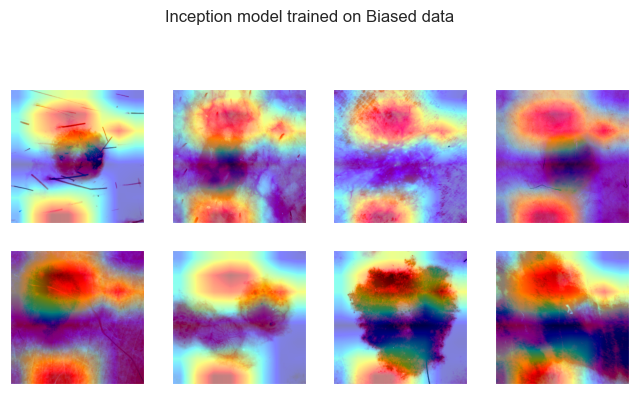

In [10]:
conv_layer_biased = inception_biased_model.base_model._modules.get('Mixed_7b')
for i in range(0,16) :get_gradcam_output(inception_biased_model, conv_layer_biased, batch_img, 'Inception model trained on Biased data', 'fc', i) 

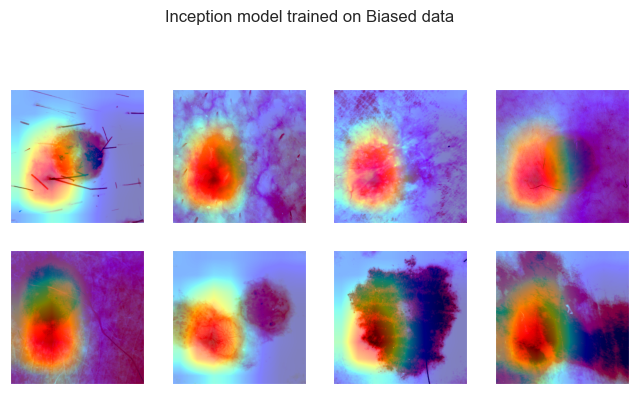

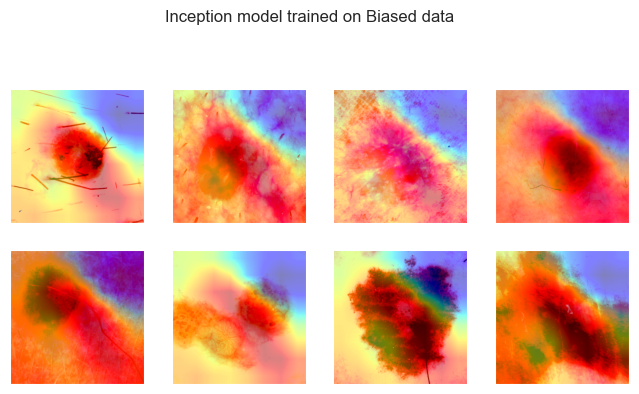

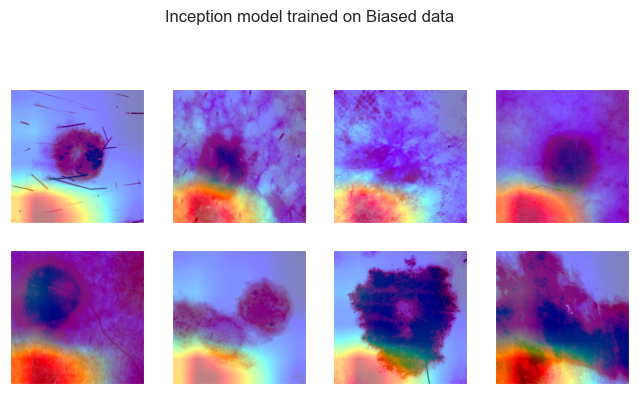

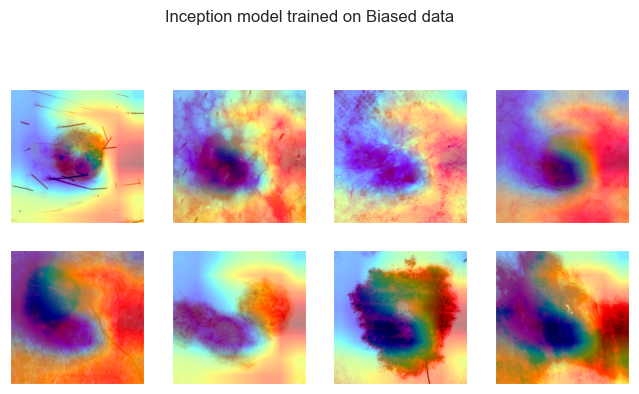

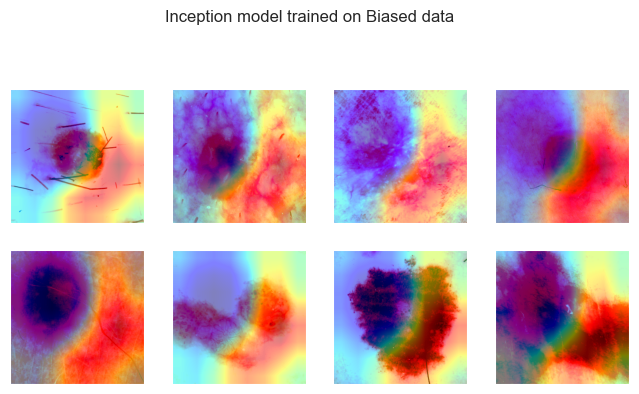

...

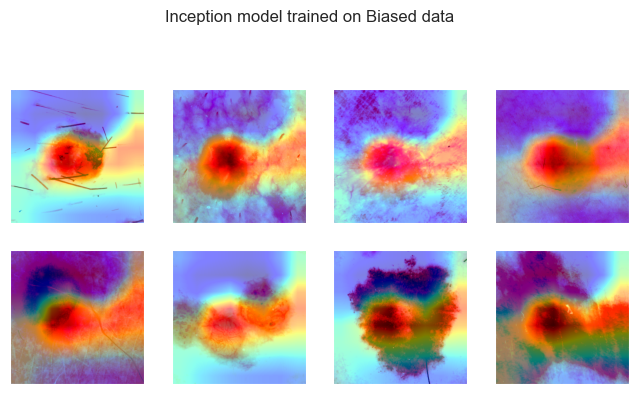

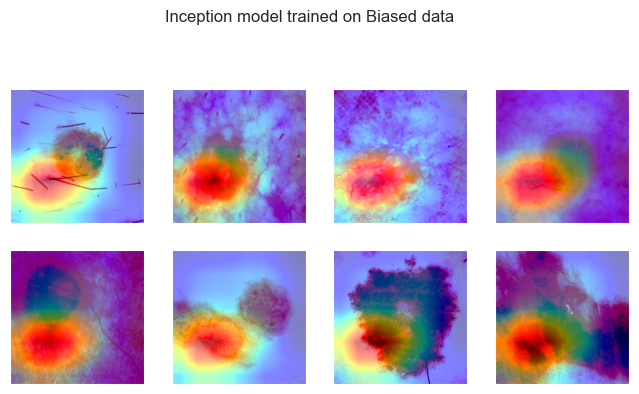

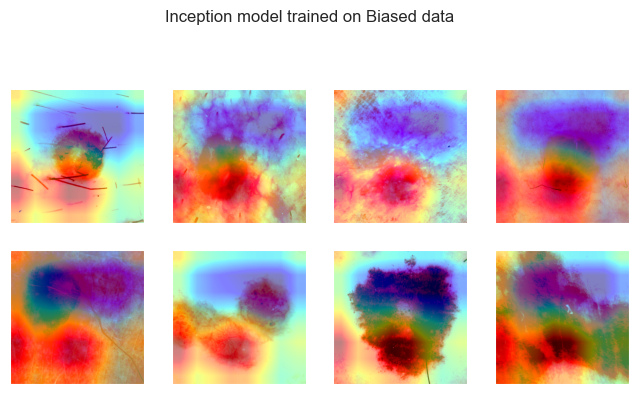

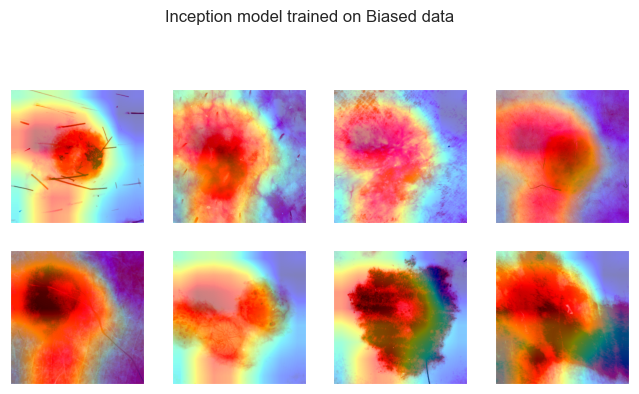

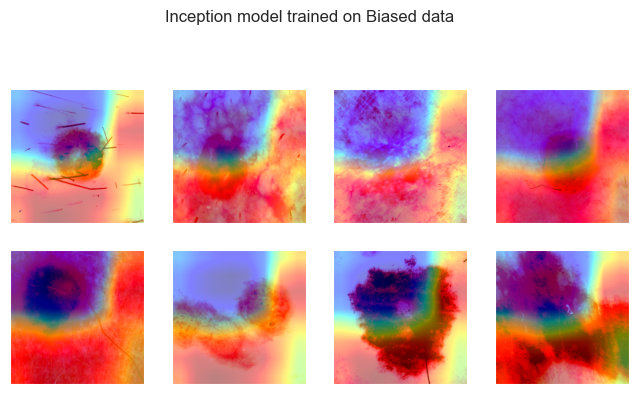

In [11]:
conv_layer_biased = inception_biased_model.base_model._modules.get('Mixed_7c')
for i in range(0,16) : get_gradcam_output(inception_biased_model, conv_layer_biased, batch_img, 'Inception model trained on Biased data','fc', i)

In [12]:
inception_unbiased_model = torch.load("model/saved_model/inception/unbiased.pickle").to('cpu')

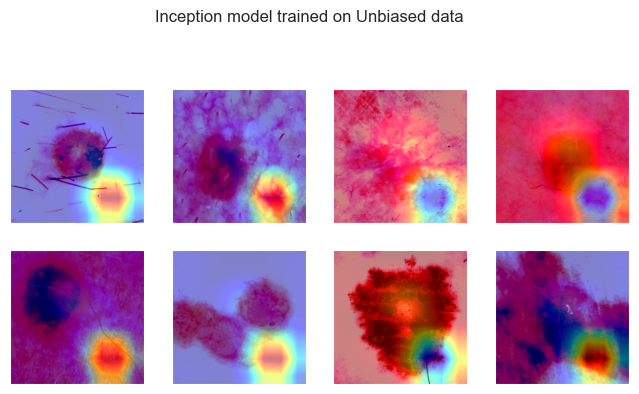

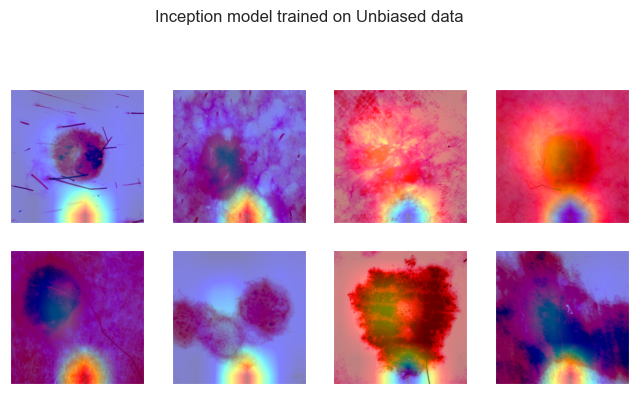

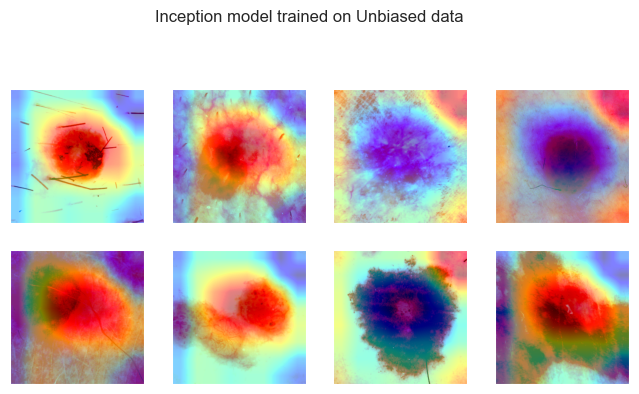

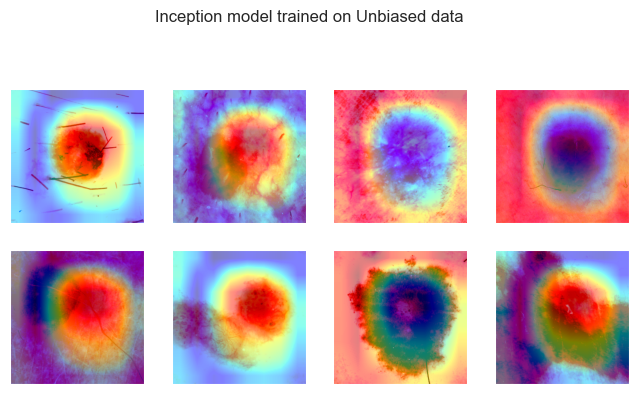

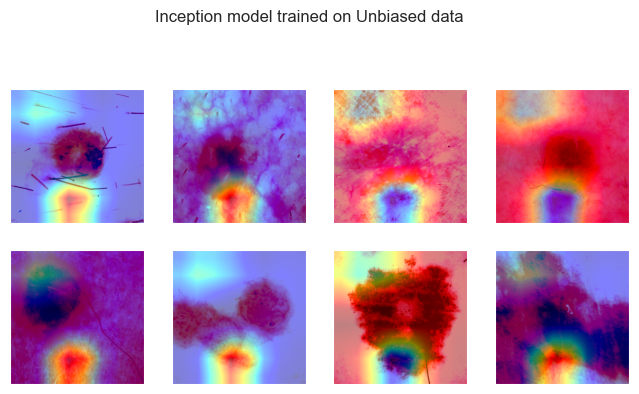

...

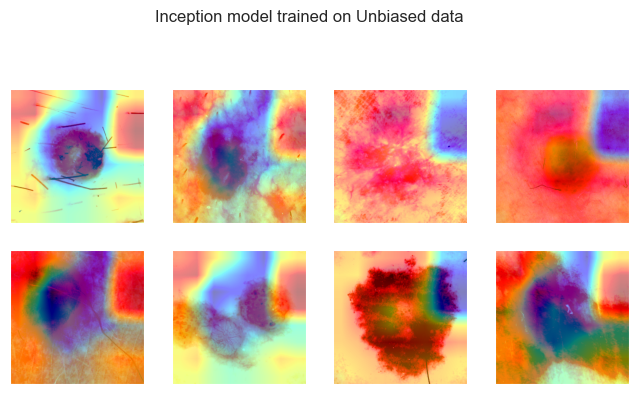

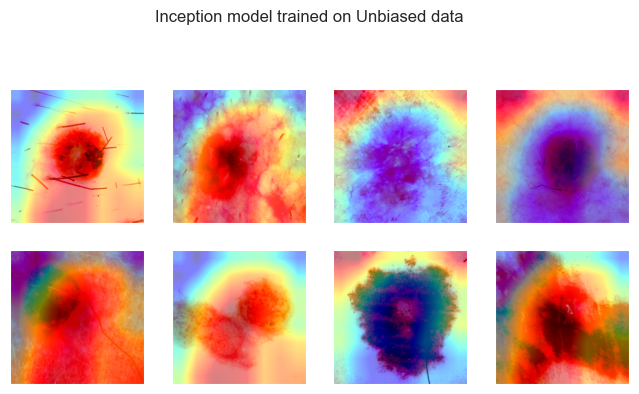

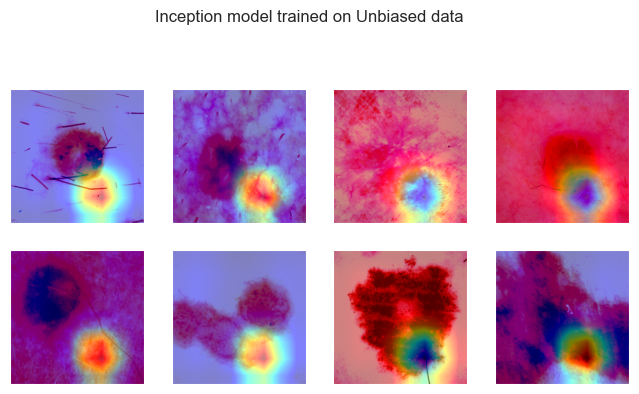

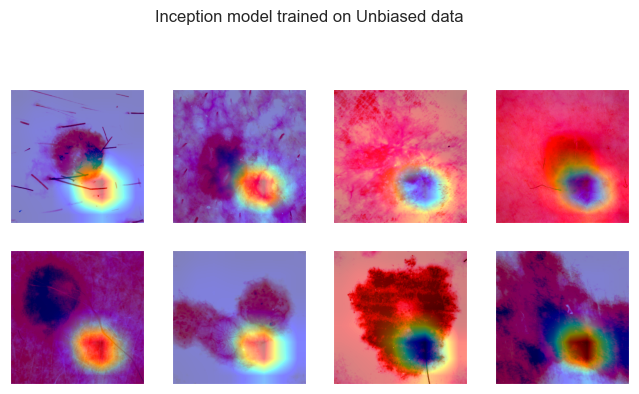

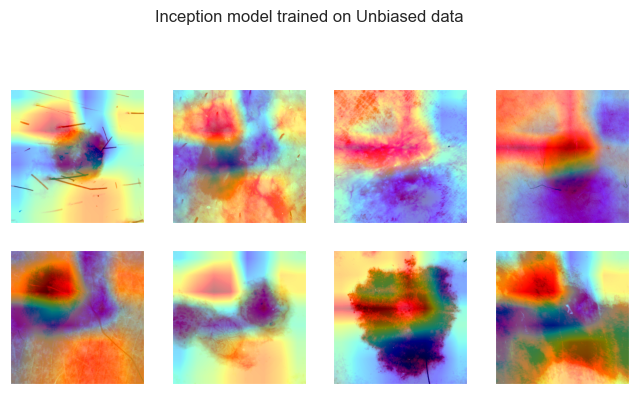

In [13]:
conv_layer_unbiased = inception_unbiased_model.base_model._modules.get('Mixed_7b')
for i in range(0,16) : get_gradcam_output(inception_unbiased_model, conv_layer_unbiased, batch_img, 'Inception model trained on Unbiased data', 'fc', i) 

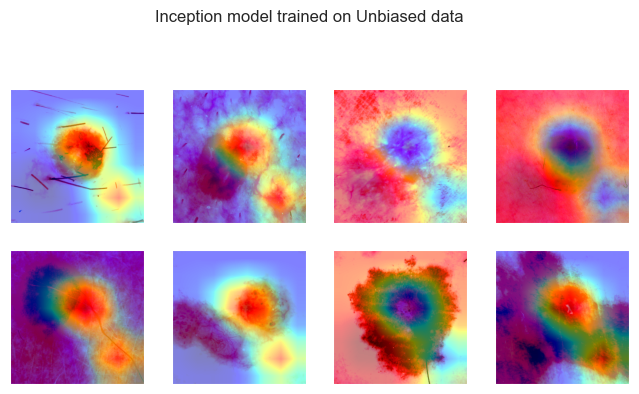

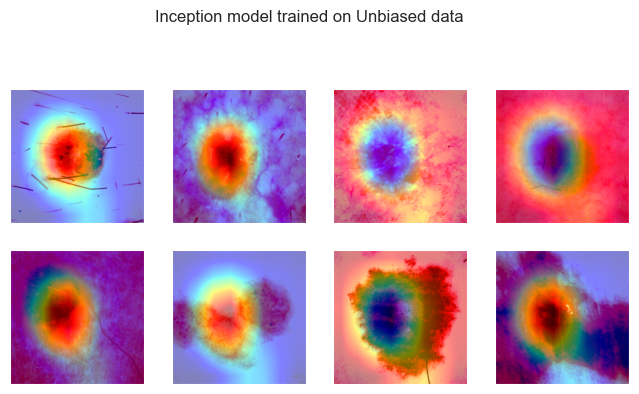

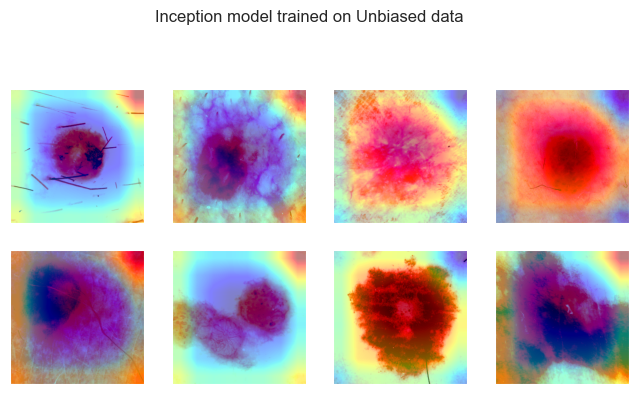

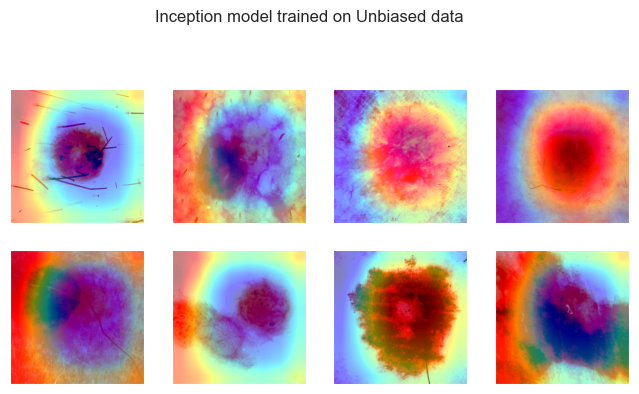

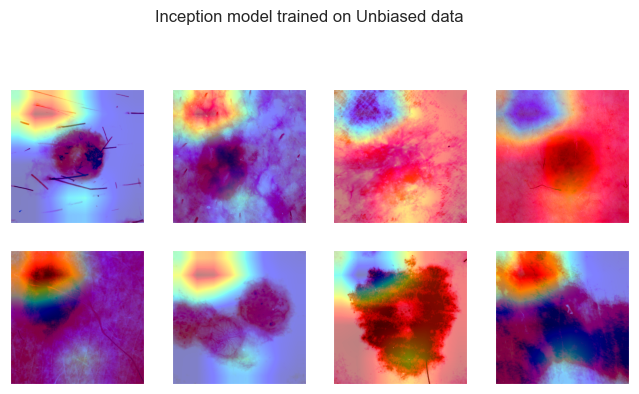

...

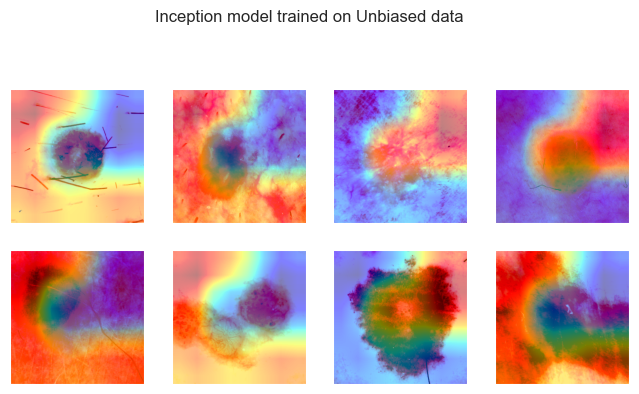

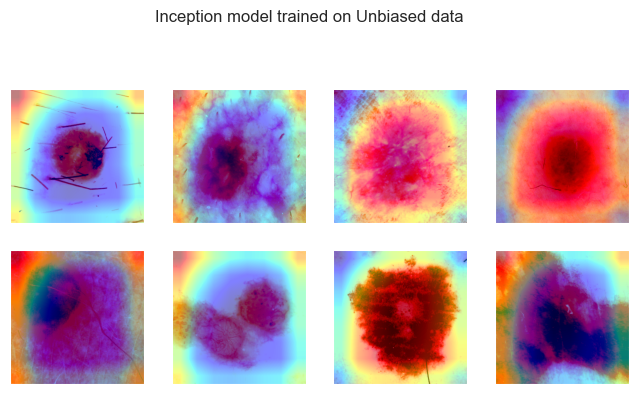

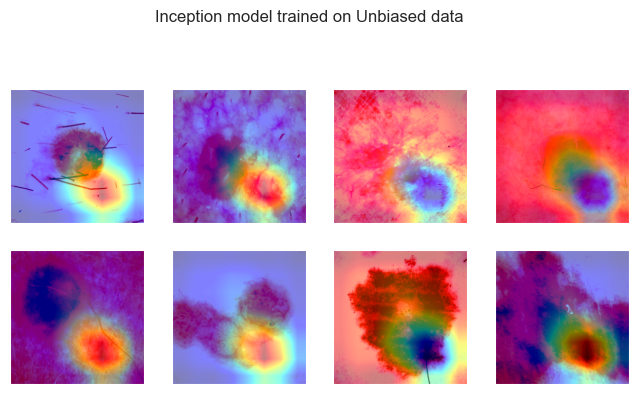

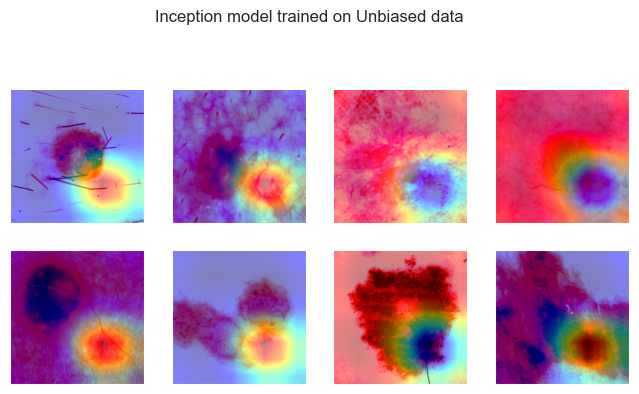

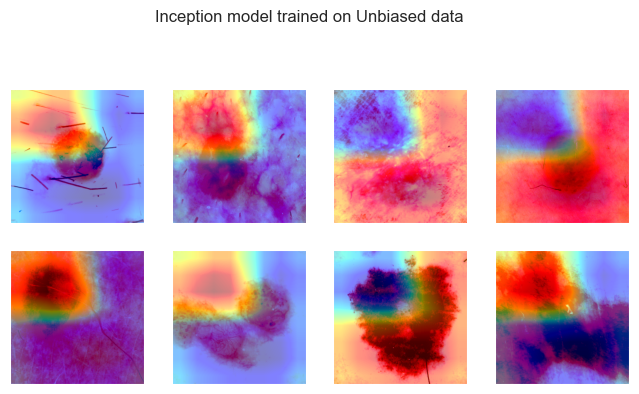

In [16]:
conv_layer_unbiased = inception_unbiased_model.base_model._modules.get('Mixed_7c')
for i in range(0,16) : get_gradcam_output(inception_unbiased_model, 
                                          conv_layer_unbiased, batch_img,
                                          'Inception model trained on Unbiased data', 'fc', i)

## Densenet Model

In [17]:
densenet_biased_model = torch.load("model/saved_model/densenet/biased.pickle").to('cpu')

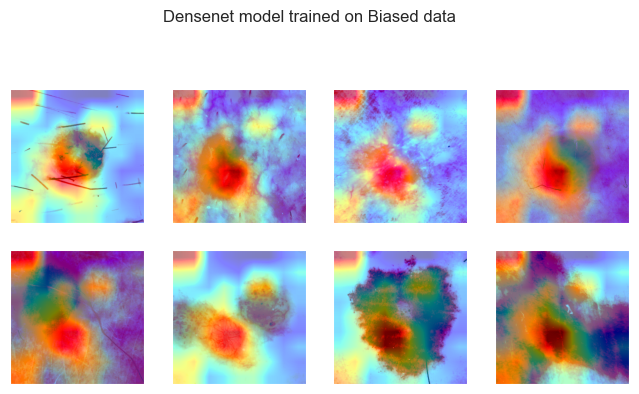

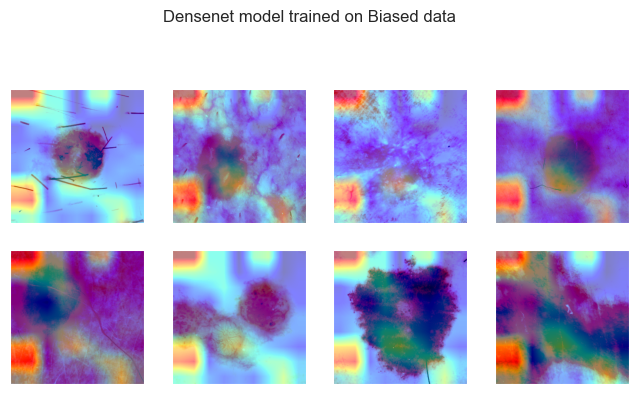

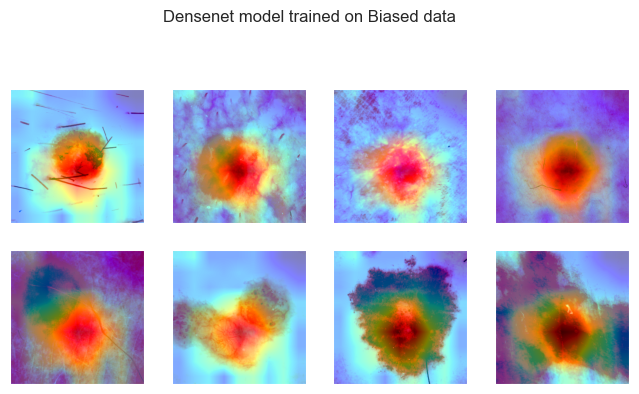

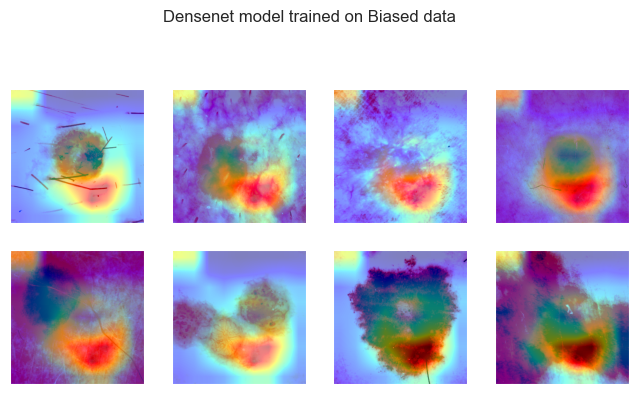

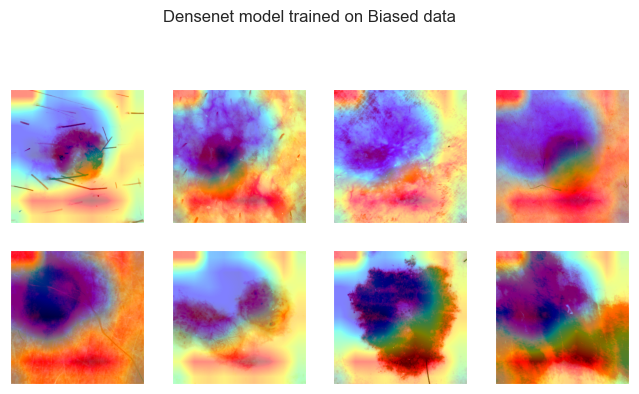

...

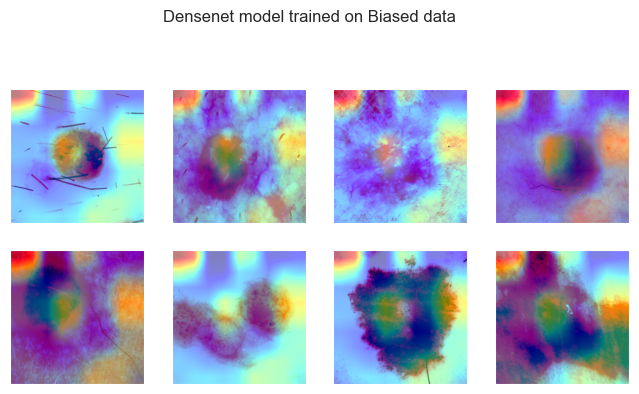

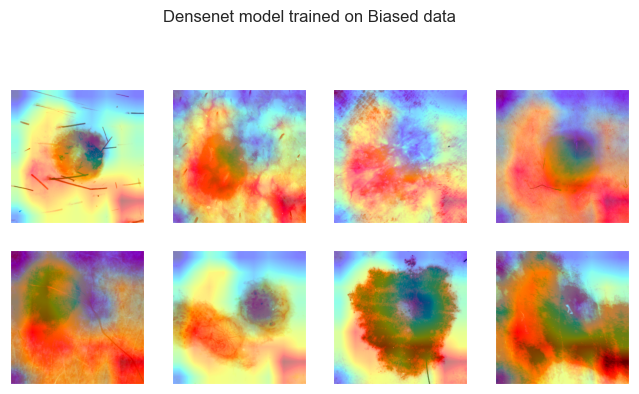

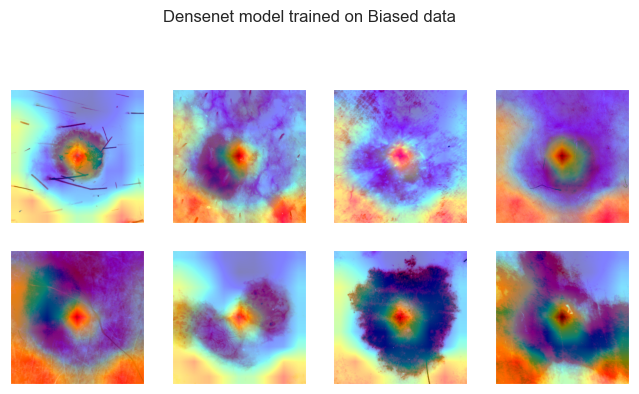

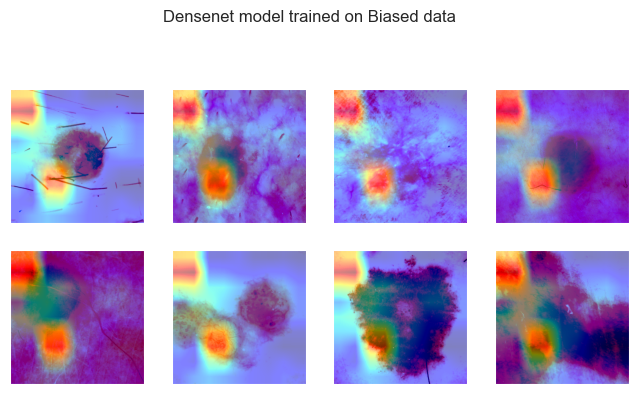

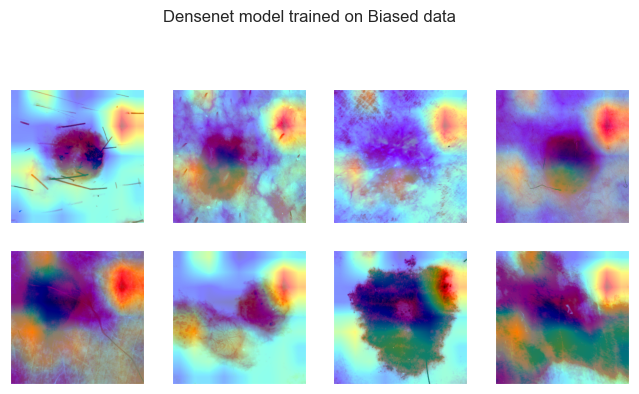

In [18]:
conv_biased_layer = densenet_biased_model.base_model._modules.get('features')._modules.get('norm5')
for i in range(0,16) : get_gradcam_output(densenet_biased_model, conv_biased_layer, batch_img, 'Densenet model trained on Biased data', 'classifier',i)

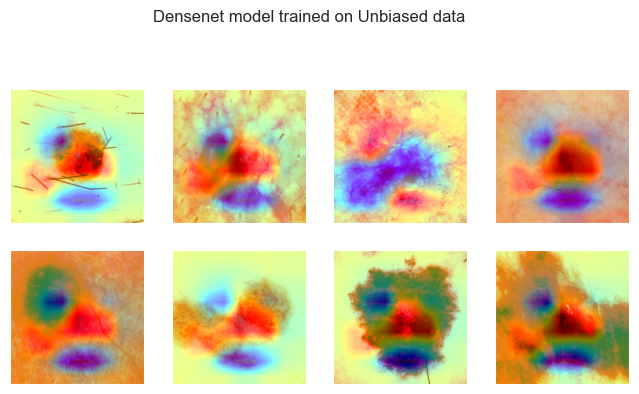

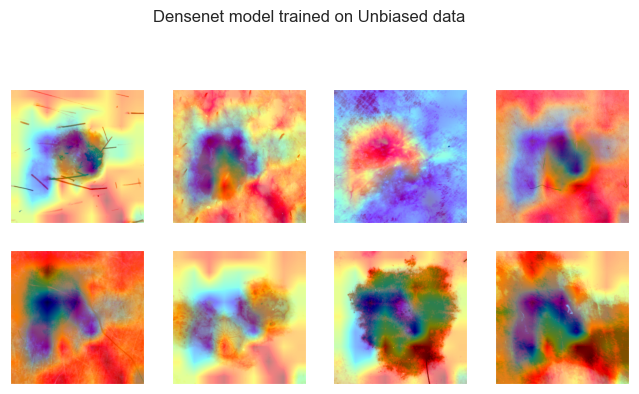

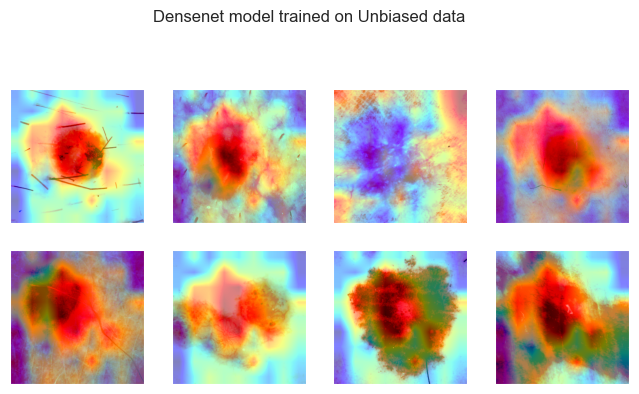

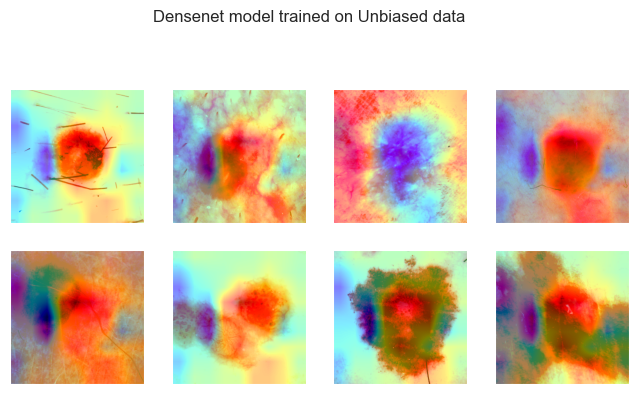

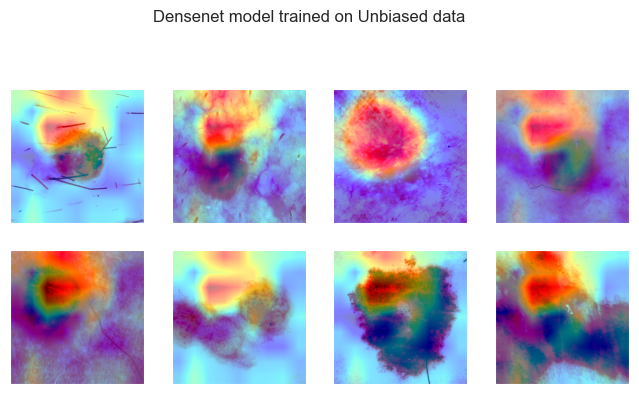

...

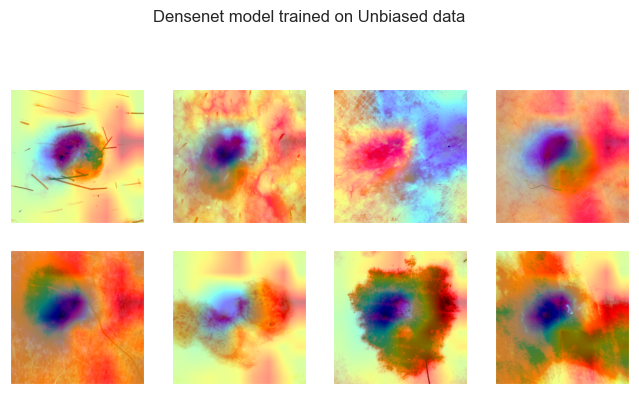

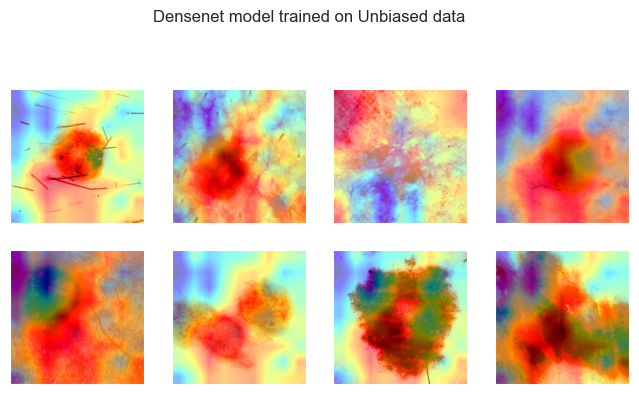

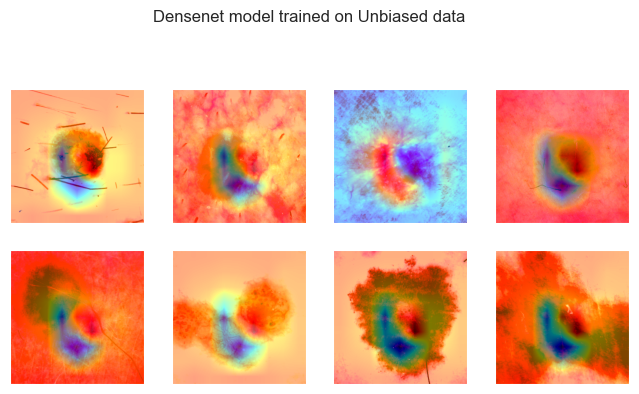

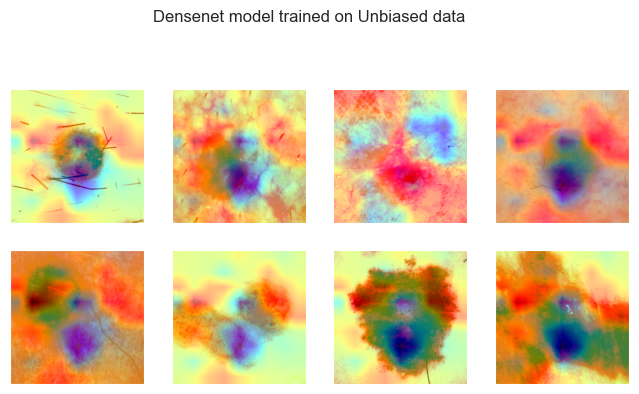

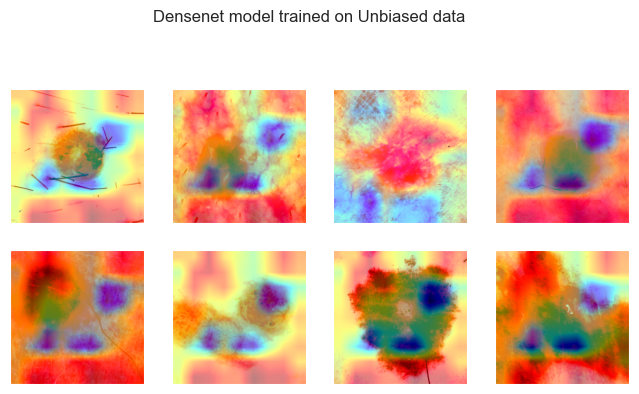

In [20]:
densenet_unbiased_model = torch.load("model/saved_model/densenet/unbiased.pickle").to('cpu')

conv_biased_layer = densenet_unbiased_model.base_model._modules.get('features')._modules.get('norm5')
for i in range(0,16) : get_gradcam_output(densenet_unbiased_model, conv_biased_layer, batch_img, 'Densenet model trained on Unbiased data', 'classifier',i)